In [26]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error    
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GroupKFold, RandomizedSearchCV, GroupShuffleSplit
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, LSTM, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
import xgboost as xgb
import tensorflow as tf
import keras_tuner as kt
from sklearn.feature_selection import VarianceThreshold

## Load the Data

In [28]:
#we define col names as there are no col names in the dataset file
index= ["engine", "cycle"]
setting = [f"op_setting_{i}" for i in range(1, 4)]
sensor = [
    "Fan inlet temperature (◦R)",
    "LPC outlet temperature (◦R)",
    "HPC outlet temperature (◦R)",
    "LPT outlet temperature (◦R)",
    "Fan inlet Pressure (psia)",
    "Bypass-duct pressure (psia)",
    "HPC outlet pressure (psia)",
    "Physical fan speed (rpm)",
    "Physical core speed (rpm)",
    "Engine pressure ratio (P50/P2)",
    "HPC outlet Static pressure (psia)",
    "Ratio of fuel flow to Ps30 (pps/psia)",
    "Corrected fan speed (rpm)",
    "Corrected core speed (rpm)",
    "Bypass Ratio",
    "Burner fuel-air ratio",
    "Bleed Enthalpy",
    "Required fan speed",
    "Required fan conversion speed",
    "High-pressure turbines Cool air flow",
    "Low-pressure turbines Cool air flow",
]
col_names = index + setting + sensor 
train = pd.read_csv("/kaggle/input/nasa-cmaps/CMaps/train_FD001.txt",sep="\s+", header=None, names = col_names) #separate by whitespace, the + is for one or more spaces
test  = pd.read_csv("/kaggle/input/nasa-cmaps/CMaps/test_FD001.txt",sep="\s+", header=None, names = col_names)
rul = pd.read_csv("/kaggle/input/nasa-cmaps/CMaps/RUL_FD001.txt", sep="\s+", header=None, names=['RUL'])


In [4]:
train.head()

,engine,cycle,op_setting_1,op_setting_2,op_setting_3,Fan inlet temperature (◦R),LPC outlet temperature (◦R),HPC outlet temperature (◦R),LPT outlet temperature (◦R),Fan inlet Pressure (psia),...,Ratio of fuel flow to Ps30 (pps/psia),Corrected fan speed (rpm),Corrected core speed (rpm),Bypass Ratio,Burner fuel-air ratio,Bleed Enthalpy,Required fan speed,Required fan conversion speed,High-pressure turbines Cool air flow,Low-pressure turbines Cool air flow
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [5]:
test.head()

,engine,cycle,op_setting_1,op_setting_2,op_setting_3,Fan inlet temperature (◦R),LPC outlet temperature (◦R),HPC outlet temperature (◦R),LPT outlet temperature (◦R),Fan inlet Pressure (psia),...,Ratio of fuel flow to Ps30 (pps/psia),Corrected fan speed (rpm),Corrected core speed (rpm),Bypass Ratio,Burner fuel-air ratio,Bleed Enthalpy,Required fan speed,Required fan conversion speed,High-pressure turbines Cool air flow,Low-pressure turbines Cool air flow
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


In [6]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   engine                                 20631 non-null  int64  
 1   cycle                                  20631 non-null  int64  
 2   op_setting_1                           20631 non-null  float64
 3   op_setting_2                           20631 non-null  float64
 4   op_setting_3                           20631 non-null  float64
 5   Fan inlet temperature (◦R)             20631 non-null  float64
 6   LPC outlet temperature (◦R)            20631 non-null  float64
 7   HPC outlet temperature (◦R)            20631 non-null  float64
 8   LPT outlet temperature (◦R)            20631 non-null  float64
 9   Fan inlet Pressure (psia)              20631 non-null  float64
 10  Bypass-duct pressure (psia)            20631 non-null  float64
 11  HP

In [7]:
train.shape

(20631, 26)

In [8]:
test.shape

(13096, 26)

In [9]:
rul.shape

(100, 1)

In [10]:
train.isna().sum()  

engine                                   0
cycle                                    0
op_setting_1                             0
op_setting_2                             0
op_setting_3                             0
Fan inlet temperature (◦R)               0
LPC outlet temperature (◦R)              0
HPC outlet temperature (◦R)              0
LPT outlet temperature (◦R)              0
Fan inlet Pressure (psia)                0
Bypass-duct pressure (psia)              0
HPC outlet pressure (psia)               0
Physical fan speed (rpm)                 0
Physical core speed (rpm)                0
Engine pressure ratio (P50/P2)           0
HPC outlet Static pressure (psia)        0
Ratio of fuel flow to Ps30 (pps/psia)    0
Corrected fan speed (rpm)                0
Corrected core speed (rpm)               0
Bypass Ratio                             0
Burner fuel-air ratio                    0
Bleed Enthalpy                           0
Required fan speed                       0
Required fa

In [11]:
test.isna().sum()

engine                                   0
cycle                                    0
op_setting_1                             0
op_setting_2                             0
op_setting_3                             0
Fan inlet temperature (◦R)               0
LPC outlet temperature (◦R)              0
HPC outlet temperature (◦R)              0
LPT outlet temperature (◦R)              0
Fan inlet Pressure (psia)                0
Bypass-duct pressure (psia)              0
HPC outlet pressure (psia)               0
Physical fan speed (rpm)                 0
Physical core speed (rpm)                0
Engine pressure ratio (P50/P2)           0
HPC outlet Static pressure (psia)        0
Ratio of fuel flow to Ps30 (pps/psia)    0
Corrected fan speed (rpm)                0
Corrected core speed (rpm)               0
Bypass Ratio                             0
Burner fuel-air ratio                    0
Bleed Enthalpy                           0
Required fan speed                       0
Required fa

In [12]:
train.duplicated().sum()

0

In [13]:
test.duplicated().sum()

0

In [14]:
print("Number of engines in train dataset:", train['engine'].nunique())

Number of engines in train dataset: 100


In [15]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
engine,20631.0,51.506568,2.922763e+01,1.0000,26.0000,52.0000,77.0000,100.0000
cycle,20631.0,108.807862,6.888099e+01,1.0000,52.0000,104.0000,156.0000,362.0000
op_setting_1,20631.0,-0.000009,2.187313e-03,-0.0087,-0.0015,0.0000,0.0015,0.0087
op_setting_2,20631.0,0.000002,2.930621e-04,-0.0006,-0.0002,0.0000,0.0003,0.0006
op_setting_3,20631.0,100.000000,0.000000e+00,100.0000,100.0000,100.0000,100.0000,100.0000
Fan inlet temperature (◦R),20631.0,518.670000,6.537152e-11,518.6700,518.6700,518.6700,518.6700,518.6700
LPC outlet temperature (◦R),20631.0,642.680934,5.000533e-01,641.2100,642.3250,642.6400,643.0000,644.5300
HPC outlet temperature (◦R),20631.0,1590.523119,6.131150e+00,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
LPT outlet temperature (◦R),20631.0,1408.933782,9.000605e+00,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
Fan inlet Pressure (psia),20631.0,14.620000,3.394700e-12,14.6200,14.6200,14.6200,14.6200,14.6200


In [29]:
#From the description of the dataframe we see some columns who seem to be constant (same min and max values) these wont help us so it is safe to drop them
constant_cols = [col for col in train.columns if train[col].nunique() == 1]

print("Columns with constant values:" , constant_cols)
train.drop(constant_cols, axis=1, inplace=True, errors='ignore')
test.drop(constant_cols, axis=1, inplace=True, errors='ignore')

Columns with constant values: ['op_setting_3', 'Fan inlet temperature (◦R)', 'Fan inlet Pressure (psia)', 'Engine pressure ratio (P50/P2)', 'Burner fuel-air ratio', 'Required fan speed', 'Required fan conversion speed']


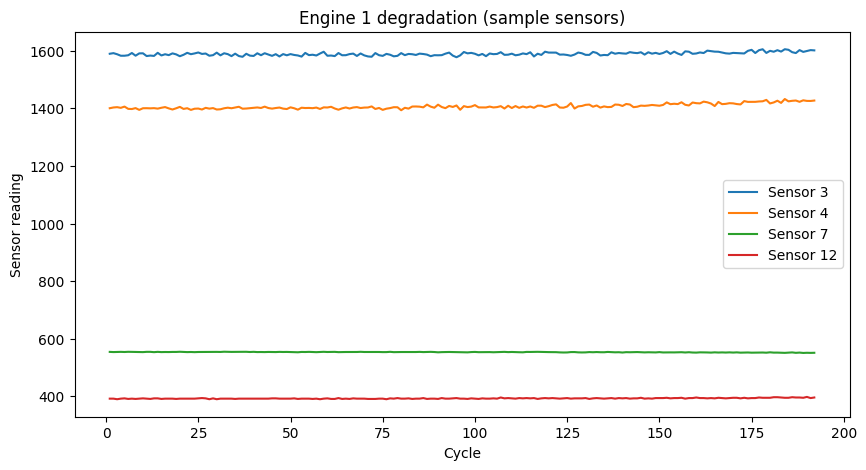

In [17]:
engine1 = train[train['engine']==1]
plt.figure(figsize=(10,5))
plt.plot(engine1['cycle'], engine1['HPC outlet temperature (◦R)'], label='Sensor 3')
plt.plot(engine1['cycle'], engine1['LPT outlet temperature (◦R)'], label='Sensor 4')
plt.plot(engine1['cycle'], engine1['HPC outlet pressure (psia)'], label='Sensor 7')
plt.plot(engine1['cycle'], engine1['Bleed Enthalpy'], label='Sensor 12')
plt.xlabel("Cycle")
plt.ylabel("Sensor reading")
plt.title("Engine 1 degradation (sample sensors)")
plt.legend()
plt.show()

In [18]:
train.shape

(20631, 19)

In [19]:
test.shape

(13096, 19)

In [30]:

#identifies max cycle for each engine
train['max_cycle'] = train.groupby('engine')['cycle'].transform('max')
#calculates RUL to each cycle 
train['RUL'] = train['max_cycle'] - train['cycle']
#remove max_cycle col as it is no longer needed
train = train.drop('max_cycle', axis=1)
train

,engine,cycle,op_setting_1,op_setting_2,LPC outlet temperature (◦R),HPC outlet temperature (◦R),LPT outlet temperature (◦R),Bypass-duct pressure (psia),HPC outlet pressure (psia),Physical fan speed (rpm),Physical core speed (rpm),HPC outlet Static pressure (psia),Ratio of fuel flow to Ps30 (pps/psia),Corrected fan speed (rpm),Corrected core speed (rpm),Bypass Ratio,Bleed Enthalpy,High-pressure turbines Cool air flow,Low-pressure turbines Cool air flow,RUL
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,21.61,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,21.61,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,21.61,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,21.61,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,21.61,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,21.61,551.43,2388.19,9065.52,48.07,519.49,2388.26,8137.60,8.4956,397,38.49,22.9735,4
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,21.61,550.86,2388.23,9065.11,48.04,519.68,2388.22,8136.50,8.5139,395,38.30,23.1594,3
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,21.61,550.94,2388.24,9065.90,48.09,520.01,2388.24,8141.05,8.5646,398,38.44,22.9333,2
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,21.61,550.68,2388.25,9073.72,48.39,519.67,2388.23,8139.29,8.5389,395,38.29,23.0640,1



Prepare the test set with RUL labels

In [31]:
#load true RUL values from RUL_FD001.txt
rul_values= rul['RUL'].values

#find the last cycle (max_cycle) for each engine in the test set
test['max_cycle'] = test.groupby('engine')['cycle'].transform('max')

#we create a new dataframe test_rul to facilitate the merge operation
#it contains each engine, its max_cycle and the corresponding true RUL value
test_rul = pd.DataFrame({"engine": test['engine'].unique(), "max_cycle": test.groupby('engine')['cycle'].max().values, "true_RUL": rul_values})

#merge this mapping back to the test set
test= test.merge(test_rul, on=['engine', 'max_cycle'], how='left')
test['RUL'] = test['true_RUL'] + (test['max_cycle'] - test['cycle']) #this computation gives the RUL for each cycle in the test set (decreases linearly)
test= test.drop(columns=['max_cycle', 'true_RUL'])
test


,engine,cycle,op_setting_1,op_setting_2,LPC outlet temperature (◦R),HPC outlet temperature (◦R),LPT outlet temperature (◦R),Bypass-duct pressure (psia),HPC outlet pressure (psia),Physical fan speed (rpm),Physical core speed (rpm),HPC outlet Static pressure (psia),Ratio of fuel flow to Ps30 (pps/psia),Corrected fan speed (rpm),Corrected core speed (rpm),Bypass Ratio,Bleed Enthalpy,High-pressure turbines Cool air flow,Low-pressure turbines Cool air flow,RUL
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,21.61,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735,142
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,21.61,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916,141
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,21.61,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166,140
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,21.61,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737,139
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,21.61,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130,138
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,643.24,1599.45,1415.79,21.61,553.41,2388.02,9142.37,47.69,520.69,2388.00,8213.28,8.4715,394,38.65,23.1974,24
13092,100,195,-0.0011,-0.0001,643.22,1595.69,1422.05,21.61,553.22,2388.05,9140.68,47.60,521.05,2388.09,8210.85,8.4512,395,38.57,23.2771,23
13093,100,196,-0.0006,-0.0003,643.44,1593.15,1406.82,21.61,553.04,2388.11,9146.81,47.57,521.18,2388.04,8217.24,8.4569,395,38.62,23.2051,22
13094,100,197,-0.0038,0.0001,643.26,1594.99,1419.36,21.61,553.37,2388.07,9148.85,47.61,521.33,2388.08,8220.48,8.4711,395,38.66,23.2699,21


## Exploratory Plots

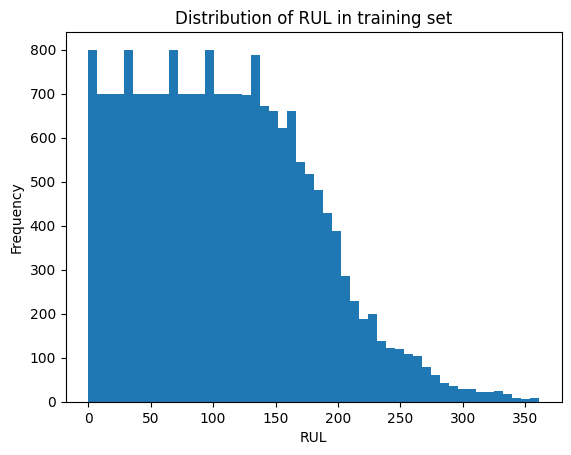

In [22]:
plt.hist(train['RUL'], bins=50)
plt.xlabel("RUL")
plt.ylabel("Frequency")
plt.title("Distribution of RUL in training set")
plt.show()

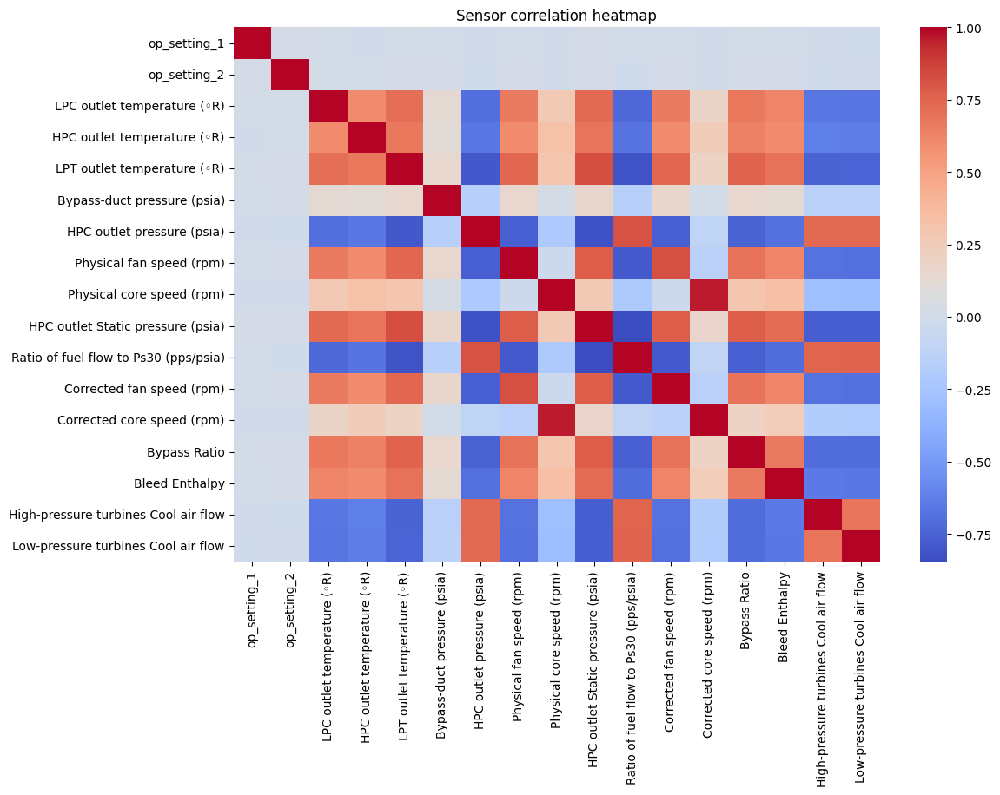

In [23]:
plt.figure(figsize=(12,8))
sns.heatmap(train.drop(columns=['engine','cycle','RUL']).corr(), cmap="coolwarm")
plt.title("Sensor correlation heatmap")
plt.show()

In [9]:
train.columns

Index(['engine', 'cycle', 'op_setting_1', 'op_setting_2',
       'LPC outlet temperature (◦R)', 'HPC outlet temperature (◦R)',
       'LPT outlet temperature (◦R)', 'Bypass-duct pressure (psia)',
       'HPC outlet pressure (psia)', 'Physical fan speed (rpm)',
       'Physical core speed (rpm)', 'HPC outlet Static pressure (psia)',
       'Ratio of fuel flow to Ps30 (pps/psia)', 'Corrected fan speed (rpm)',
       'Corrected core speed (rpm)', 'Bypass Ratio', 'Bleed Enthalpy',
       'High-pressure turbines Cool air flow',
       'Low-pressure turbines Cool air flow', 'RUL'],
      dtype='object')

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

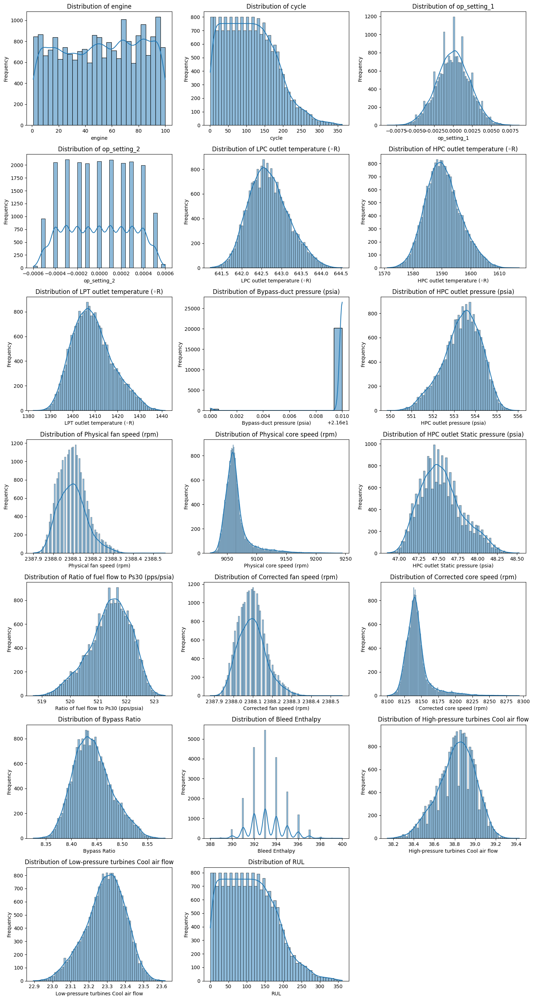

In [24]:
n_cols = len(train.columns)

# Set number of rows and columns for subplots
n_cols_per_row = 3
n_rows = math.ceil(n_cols / n_cols_per_row)

plt.figure(figsize=(5 * n_cols_per_row, 4 * n_rows))  # Adjust figure size as needed

for i, col in enumerate(train.columns, 1):
    plt.subplot(n_rows, n_cols_per_row, i)
    sns.histplot(train[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

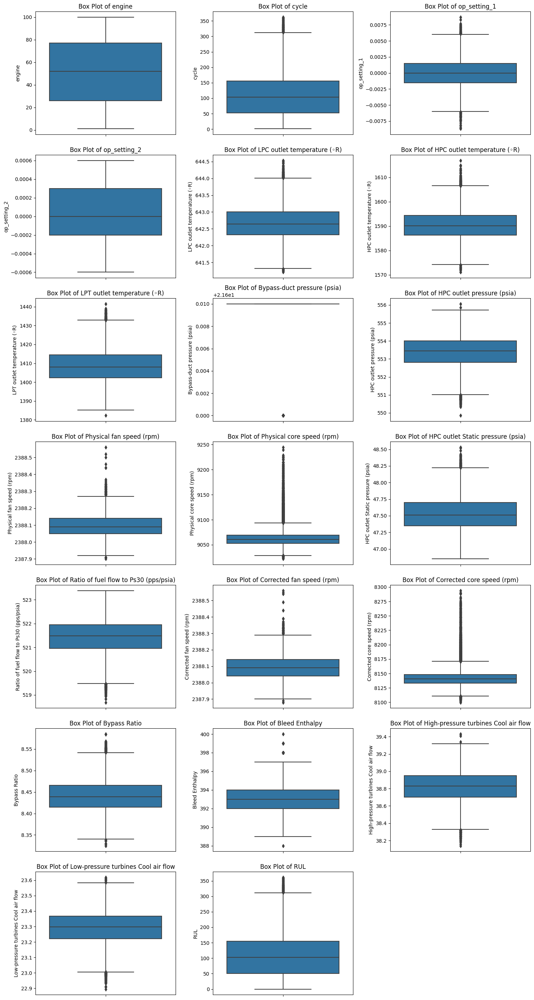

In [25]:
plt.figure(figsize=(5 * n_cols_per_row, 4 * n_rows))  # Adjust figure size as needed

for i, col in enumerate(train.columns, 1):
    plt.subplot(n_rows, n_cols_per_row, i)
    sns.boxplot(y=train[col])
    plt.title(f'Box Plot of {col}')

plt.tight_layout()
plt.show()

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated a

<Figure size 3000x3000 with 0 Axes>

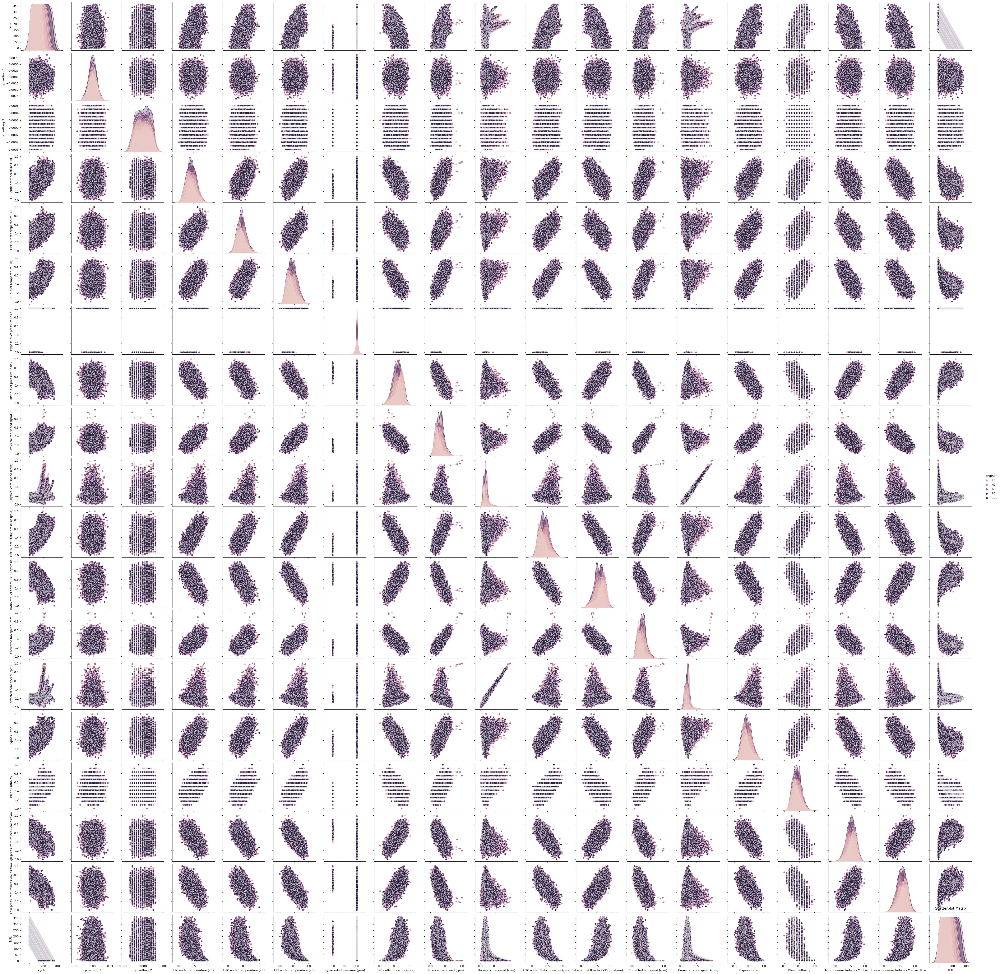

In [16]:
plt.figure(figsize=(30, 30))
sns.pairplot(train, hue="engine")
plt.title('Scatterplot Matrix')
plt.show()

## Milestone 2:

### Simple Feature engineering

In [32]:
scaler = MinMaxScaler()
sensor_cols = [c for c in train.columns if c not in ['engine','cycle','RUL','op_setting_1','op_setting_2']]

train[sensor_cols] = scaler.fit_transform(train[sensor_cols])
test[sensor_cols] = scaler.transform(test[sensor_cols])

### Time-series Analysis

rolling mean with window = 3 (look back 3 cycles each time), smoother and shows actual trends
Rolling standard deviation (std) → measures variability

If it’s high, the engine is unstable

Rolling min/max → captures recent extremes

Rolling sum → cumulative signal in the last N cycles

In [33]:

useful_sensors = [col for col in sensor_cols if col not in constant_cols]
print("Useful sensors:", useful_sensors)


Useful sensors: ['LPC outlet temperature (◦R)', 'HPC outlet temperature (◦R)', 'LPT outlet temperature (◦R)', 'Bypass-duct pressure (psia)', 'HPC outlet pressure (psia)', 'Physical fan speed (rpm)', 'Physical core speed (rpm)', 'HPC outlet Static pressure (psia)', 'Ratio of fuel flow to Ps30 (pps/psia)', 'Corrected fan speed (rpm)', 'Corrected core speed (rpm)', 'Bypass Ratio', 'Bleed Enthalpy', 'High-pressure turbines Cool air flow', 'Low-pressure turbines Cool air flow']


In [34]:
#short term trends
for col in useful_sensors:
    train[col+'_avg5'] = train.groupby('engine')[col].rolling(window=5, min_periods=1).mean().reset_index(0,drop=True)
    test[col+'_avg5'] = test.groupby('engine')[col].rolling(window=5, min_periods=1).mean().reset_index(0,drop=True)

In [35]:
for col in useful_sensors:
    train[col+'_std5'] = train.groupby('engine')[col].rolling(window=5, min_periods=1).std().reset_index(0,drop=True)
    test[col+'_std5'] = test.groupby('engine')[col].rolling(window=5, min_periods=1).std().reset_index(0,drop=True)

In [36]:
#long term trends
for col in useful_sensors:  
    train[col+'_avg20'] = train.groupby('engine')[col].rolling(window=20, min_periods=1).mean().reset_index(0,drop=True)
    test[col+'_avg20'] = test.groupby('engine')[col].rolling(window=20, min_periods=1).mean().reset_index(0,drop=True)

In [37]:
#delta features see how fast things change
for col in useful_sensors:
    train[col+'_diff'] = train.groupby('engine')[col].diff().fillna(0)
    test[col+'_diff'] = test.groupby('engine')[col].diff().fillna(0)

In [38]:
train['cycle_norm'] = train['cycle'] / train.groupby('engine')['cycle'].transform('max')
test['cycle_norm']  = test['cycle'] / test.groupby('engine')['cycle'].transform('max')

Features so far: 

- Rolling means (5, 20 cycles)

- Rolling std (5 cycles)

- Diff features (rate of change)

- Cycle normalization


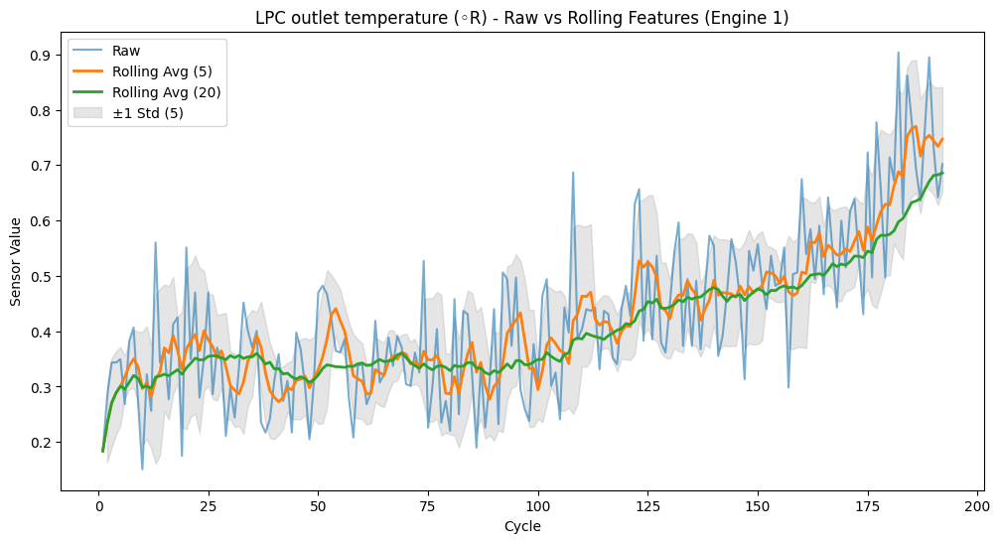

In [23]:

engine_id = 1
sensor = useful_sensors[0] 

unit_df = train[train['engine'] == engine_id]

plt.figure(figsize=(12,6))
plt.plot(unit_df['cycle'], unit_df[sensor], label='Raw', alpha=0.6)
plt.plot(unit_df['cycle'], unit_df[sensor+'_avg5'], label='Rolling Avg (5)', linewidth=2)
plt.plot(unit_df['cycle'], unit_df[sensor+'_avg20'], label='Rolling Avg (20)', linewidth=2)
plt.fill_between(unit_df['cycle'],
                 unit_df[sensor+'_avg5'] - unit_df[sensor+'_std5'],
                 unit_df[sensor+'_avg5'] + unit_df[sensor+'_std5'],
                 color='gray', alpha=0.2, label='±1 Std (5)')
plt.xlabel("Cycle")
plt.ylabel("Sensor Value")
plt.title(f"{sensor} - Raw vs Rolling Features (Engine {engine_id})")
plt.legend()
plt.show()


Degradation trends of all useful sensors across engines

For each sensor, i plotted its 20-cycle rolling average (_avg20) against Remaining Useful Life (RUL) for every 10th engine

RUL decreases from left to right, approaching failure at RUL = 0.

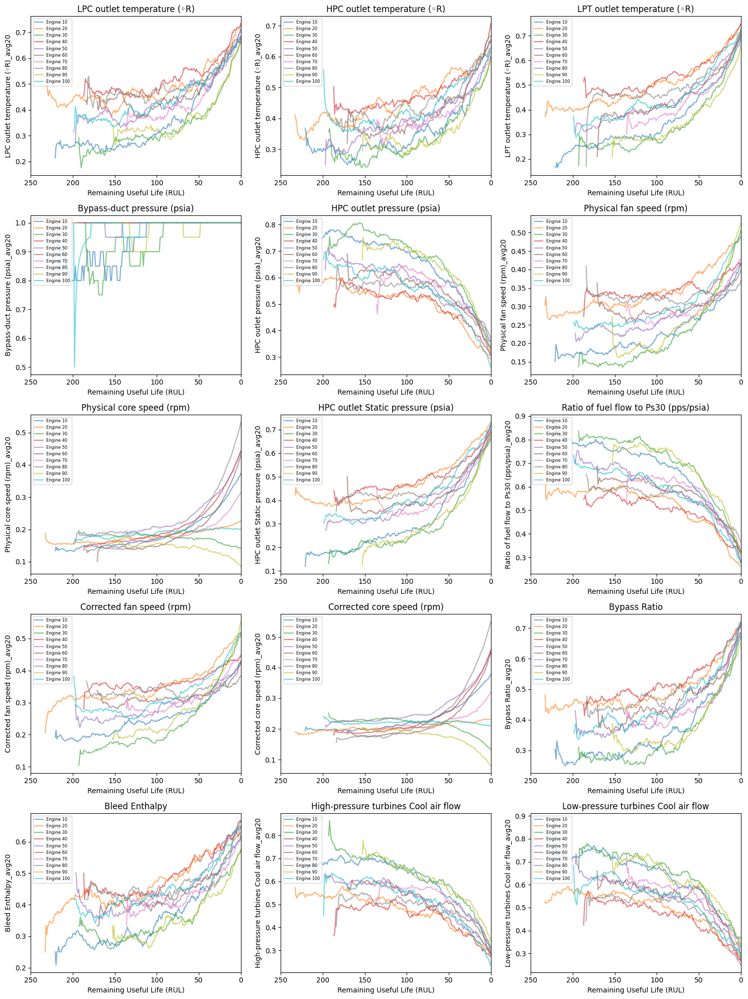

In [39]:
n = len(useful_sensors)
rows = (n // 3)
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*4))
axes = axes.flatten()

for i, sensor in enumerate(useful_sensors):
    for engine_id in sorted(train['engine'].unique()):
        if engine_id % 10 == 0:
            engine_df = train[train['engine'] == engine_id]
            axes[i].plot(engine_df['RUL'], engine_df[sensor+'_avg20'], alpha=0.6, label=f"Engine {engine_id}")
    axes[i].set_title(sensor)
    axes[i].set_xlim(250, 0)
    axes[i].set_xlabel("Remaining Useful Life (RUL)")
    axes[i].set_ylabel(sensor + "_avg20")
    axes[i].legend(fontsize=6, loc="upper left") 

plt.tight_layout()
plt.show()


Produces same results but separately 

In [40]:
def plot_sensor_trend(df, sensor_col):
    plt.figure(figsize=(8,6))

    for engine_id in sorted(df['engine'].unique()):
        if engine_id % 10 == 0:
            engine_df = df[df['engine'] == engine_id]
            plt.plot(engine_df['RUL'], engine_df[sensor_col+'_avg20'], label=f'Engine {engine_id}')

    plt.xlim(250, 0)  
    plt.xticks(np.arange(0, 300, 25))
    plt.xlabel("Remaining Useful Life (RUL)")
    plt.ylabel(sensor_col + "_avg20")
    plt.title(f"{sensor_col} (20-cycle rolling mean) across engines")
    plt.legend()
    plt.show()


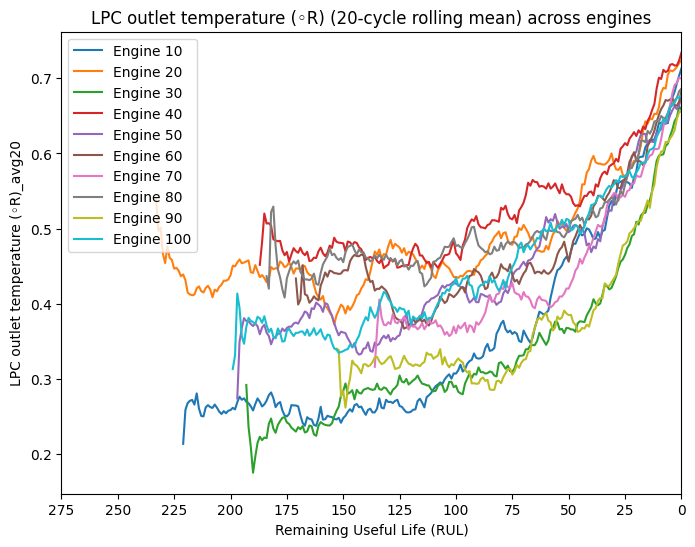

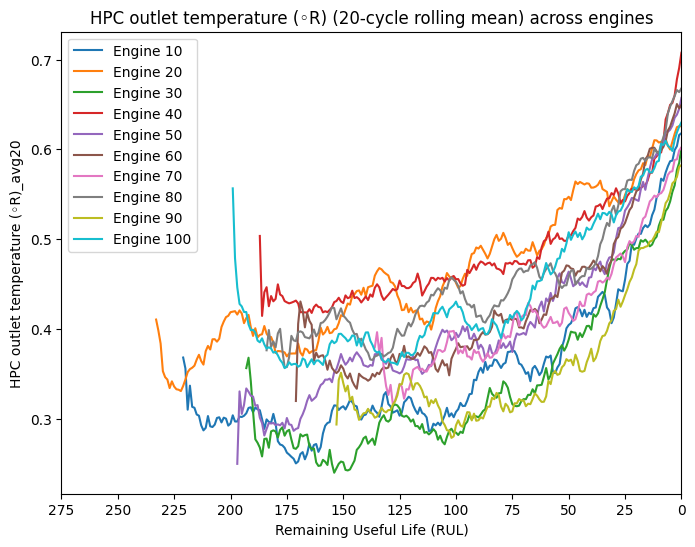

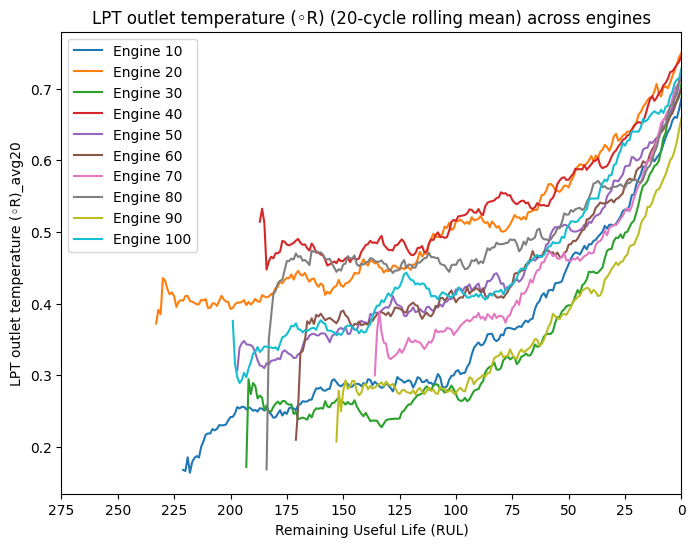

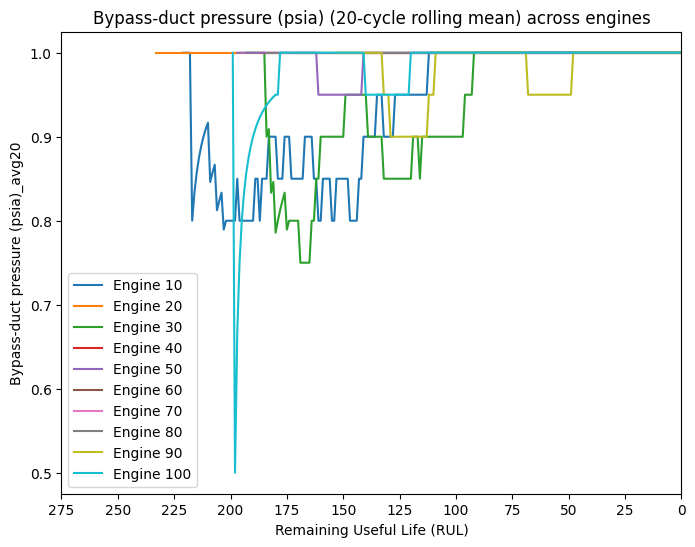

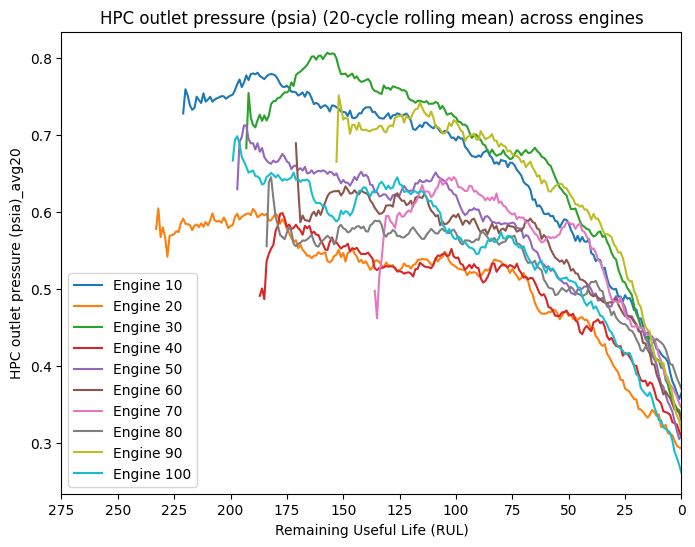

...

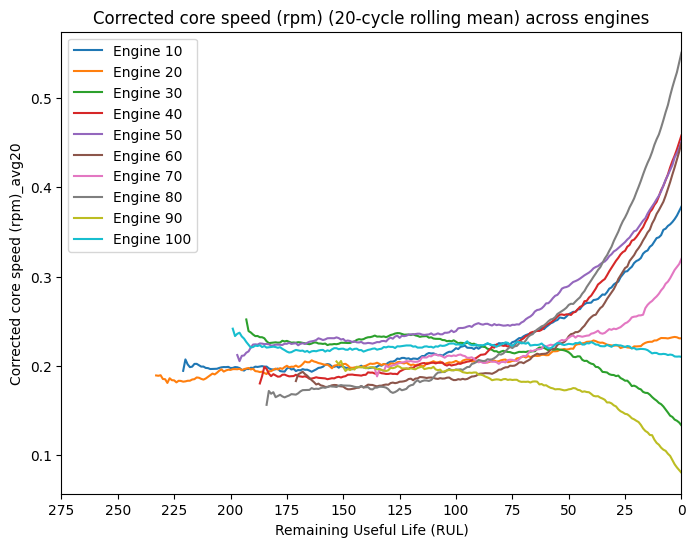

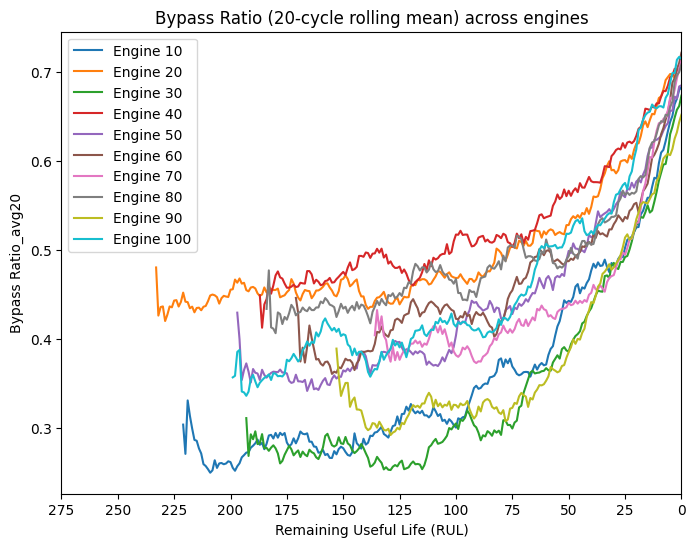

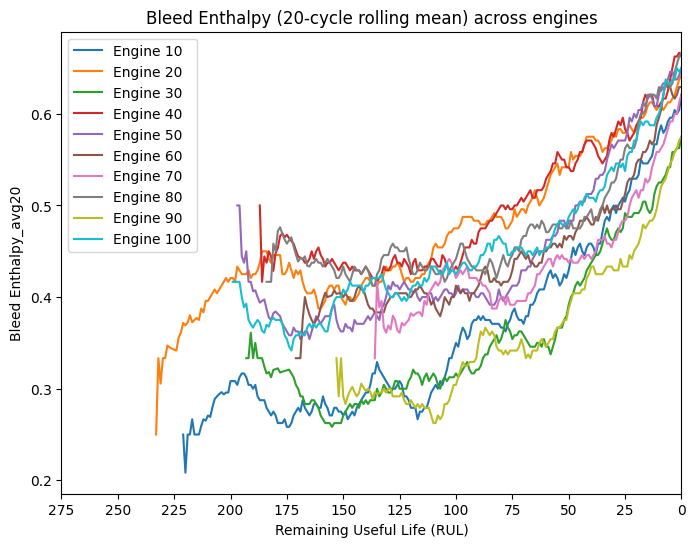

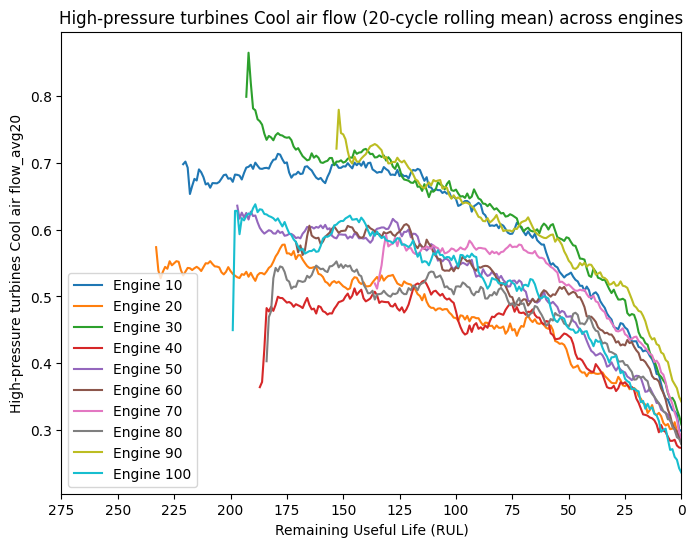

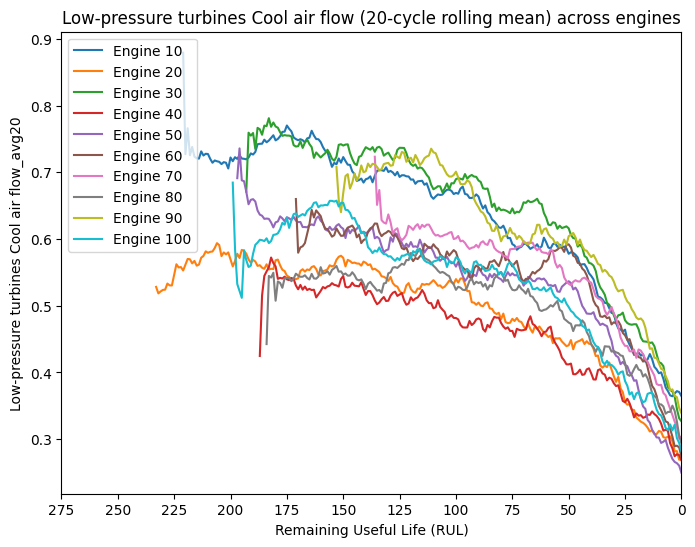

In [41]:
for sensor in useful_sensors:
    plot_sensor_trend(train, sensor)



Sensors that exhibit clear downward or upward trends as RUL approaches zero are more informative for Remaining Useful Life prediction. Conversely, sensors that remain flat or noisy across engines are less useful and may be excluded from the final feature set

Top sensors most correlated with Remaining Useful Life (RUL)

This approach reduces clutter while still capturing representative degradation patterns across the fleet

Likely strong candidates for predictive modeling

In [42]:

corrs = train[useful_sensors + ['RUL']].corr()['RUL'].drop('RUL').abs()
top_sensors = corrs.sort_values(ascending=False).head(7).index.tolist()
print("Top sensors correlated with RUL:", top_sensors)


Top sensors correlated with RUL: ['HPC outlet Static pressure (psia)', 'LPT outlet temperature (◦R)', 'Ratio of fuel flow to Ps30 (pps/psia)', 'HPC outlet pressure (psia)', 'Bypass Ratio', 'Low-pressure turbines Cool air flow', 'High-pressure turbines Cool air flow']


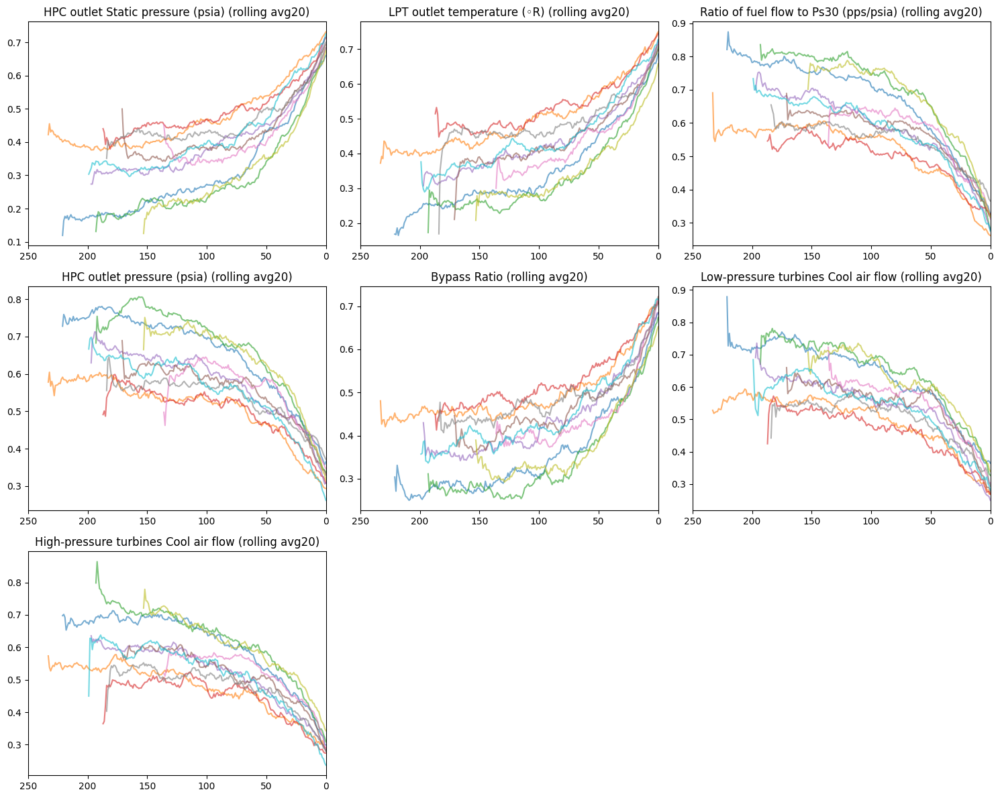

In [43]:

n = len(top_sensors)
rows = (n // 3) + 1 
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*4))
axes = axes.flatten()

for i, sensor in enumerate(top_sensors):
    for engine_id in sorted(train['engine'].unique()):
        if engine_id % 10 == 0:  
            engine_df = train[train['engine'] == engine_id]
            axes[i].plot(engine_df['RUL'], engine_df[sensor+'_avg20'], alpha=0.6)
    axes[i].set_title(f"{sensor} (rolling avg20)")
    axes[i].set_xlim(250, 0)

for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


## Milestone 3:

### 1st workflow:

correlation filtering --> random forest regressor / xgboost  --> evaluation

Correlation filtering removes redundancy

In [40]:
train.columns

Index(['engine', 'cycle', 'op_setting_1', 'op_setting_2',
       'LPC outlet temperature (◦R)', 'HPC outlet temperature (◦R)',
       'LPT outlet temperature (◦R)', 'Bypass-duct pressure (psia)',
       'HPC outlet pressure (psia)', 'Physical fan speed (rpm)',
       'Physical core speed (rpm)', 'HPC outlet Static pressure (psia)',
       'Ratio of fuel flow to Ps30 (pps/psia)', 'Corrected fan speed (rpm)',
       'Corrected core speed (rpm)', 'Bypass Ratio', 'Bleed Enthalpy',
       'High-pressure turbines Cool air flow',
       'Low-pressure turbines Cool air flow', 'RUL',
       'LPC outlet temperature (◦R)_avg5', 'HPC outlet temperature (◦R)_avg5',
       'LPT outlet temperature (◦R)_avg5', 'Bypass-duct pressure (psia)_avg5',
       'HPC outlet pressure (psia)_avg5', 'Physical fan speed (rpm)_avg5',
       'Physical core speed (rpm)_avg5',
       'HPC outlet Static pressure (psia)_avg5',
       'Ratio of fuel flow to Ps30 (pps/psia)_avg5',
       'Corrected fan speed (rpm)_avg5', '

In [4]:
print("Features before correlation filtering:", train.shape)
X = train.drop(columns=['engine', 'cycle', 'cycle_norm', 'RUL'])
y = train['RUL']


corr_matrix = X.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]
X_corr_filtered = X.drop(columns=to_drop)


print("Remaining features after correlation filtering:", X_corr_filtered.shape)


Features before correlation filtering: (20631, 81)
Remaining features after correlation filtering: (20631, 58)


/usr/local/lib/python3.11/dist-packages/pandas/core/computation/expressions.py:73: RuntimeWarning: invalid value encountered in greater
  return op(a, b)


In [42]:
X_corr_filtered.columns

Index(['cycle', 'op_setting_1', 'op_setting_2', 'LPC outlet temperature (◦R)',
       'HPC outlet temperature (◦R)', 'LPT outlet temperature (◦R)',
       'Bypass-duct pressure (psia)', 'HPC outlet pressure (psia)',
       'Physical fan speed (rpm)', 'Physical core speed (rpm)',
       'HPC outlet Static pressure (psia)',
       'Ratio of fuel flow to Ps30 (pps/psia)', 'Corrected fan speed (rpm)',
       'Bypass Ratio', 'Bleed Enthalpy',
       'High-pressure turbines Cool air flow',
       'Low-pressure turbines Cool air flow',
       'LPC outlet temperature (◦R)_avg5', 'HPC outlet temperature (◦R)_avg5',
       'LPT outlet temperature (◦R)_avg5', 'Bypass-duct pressure (psia)_avg5',
       'HPC outlet pressure (psia)_avg5', 'Physical fan speed (rpm)_avg5',
       'Bypass Ratio_avg5', 'Bleed Enthalpy_avg5',
       'High-pressure turbines Cool air flow_avg5',
       'Low-pressure turbines Cool air flow_avg5',
       'LPC outlet temperature (◦R)_std5', 'HPC outlet temperature (◦R)_std5',

In [43]:
X_corr_filtered.isna().sum()[X_corr_filtered.isna().sum() > 0]

LPC outlet temperature (◦R)_std5              100
HPC outlet temperature (◦R)_std5              100
LPT outlet temperature (◦R)_std5              100
Bypass-duct pressure (psia)_std5              100
HPC outlet pressure (psia)_std5               100
Physical fan speed (rpm)_std5                 100
Physical core speed (rpm)_std5                100
HPC outlet Static pressure (psia)_std5        100
Ratio of fuel flow to Ps30 (pps/psia)_std5    100
Corrected fan speed (rpm)_std5                100
Corrected core speed (rpm)_std5               100
Bypass Ratio_std5                             100
Bleed Enthalpy_std5                           100
High-pressure turbines Cool air flow_std5     100
Low-pressure turbines Cool air flow_std5      100
dtype: int64

_std5 features created with rolling std need previous rows, so early ones are NaN, Each engine contributes 4 missing values, totaling ~100

In [5]:

combined = pd.concat([X_corr_filtered, y], axis=1).dropna()
X_corr_filtered = combined.drop(columns=['RUL'])
y = combined['RUL'] # we update y to match the filtered X to avoid misalignment due to dropped rows


### 2nd workflow



corr filtering --> pca --> modeling --> evaluation

Original features: 58
Reduced features: 14


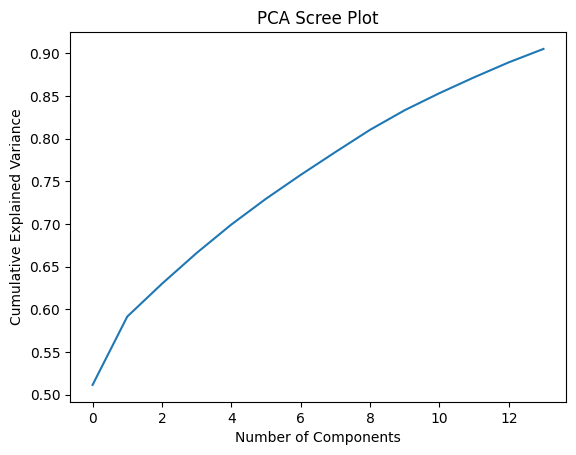

In [3]:
# dropping this for now
pca = PCA(n_components=0.9)  
X_pca = pca.fit_transform(X_corr_filtered)

print("Original features:", X_corr_filtered.shape[1])
print("Reduced features:", X_pca.shape[1])

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("PCA Scree Plot")
plt.show()

In [2]:
y = combined['RUL']
X_train, X_val, y_train, y_val = train_test_split(
    X_pca, y, test_size=0.2, random_state=42
)

In [6]:

y = combined['RUL']
X_train, X_val, y_train, y_val = train_test_split(
    X_corr_filtered, y, test_size=0.2, random_state=42
)

In [15]:
X_test = test.drop(columns=['engine', 'cycle', 'cycle_norm', 'RUL'])
y_test = test['RUL']

# correlation filtering
X_corr_filtered_test = X_test.drop(columns=to_drop)

combined = pd.concat([X_corr_filtered_test, y_test], axis=1).dropna()
X_corr_filtered_test = combined.drop(columns=['RUL'])
y_test = combined['RUL']

In [10]:
xgb_model = xgb.XGBRegressor(
    n_estimators=500,
    learning_rate=0.05,
    max_depth=6,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    n_jobs=-1,
    early_stopping_rounds=50
)

xgb_model.fit(X_train, y_train, eval_set=[(X_val, y_val)], verbose=False)

y_pred = xgb_model.predict(X_corr_filtered_test)
#y_pred = xgb_model.predict(X_val)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("XGBoost (Correlation Filtered Features)")
print("RMSE:", rmse)
print("MAE:", mae)
print("R2:", r2)

XGBoost (Correlation Filtered Features)
RMSE: 45.84104638359491
MAE: 34.51299360760471
R2: 0.3923735318632303


In [13]:
# trying hyperparameter tuning

xgb_model = xgb.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)

xgb_params = {
    'n_estimators': [300, 500, 800],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [4, 6, 8],
    'subsample': [0.7, 0.9, 1.0],
    'colsample_bytree': [0.7, 0.9, 1.0],
    'min_child_weight': [1, 3, 5]
}

xgb_search = RandomizedSearchCV(
    xgb_model,
    param_distributions=xgb_params,
    n_iter=25,
    scoring='neg_root_mean_squared_error',
    cv=3,
    verbose=2,
    n_jobs=-1,
    random_state=42
)
xgb_search.fit(X_train, y_train)

best_xgb = xgb_search.best_estimator_
print("Best XGB Params:", xgb_search.best_params_)

y_pred = best_xgb.predict(X_val)
xgb_rmse = np.sqrt(mean_squared_error(y_val, y_pred))
xgb_mae  = mean_absolute_error(y_val, y_pred)
xgb_r2   = r2_score(y_val, y_pred)

print("\n XGBoost Performance")
print("======================")
print(f"RMSE: {xgb_rmse:.2f}")
print(f"MAE:  {xgb_mae:.2f}")
print(f"R²:   {xgb_r2:.3f}")


Fitting 3 folds for each of 25 candidates, totalling 75 fits
Best XGB Params: {'subsample': 0.9, 'n_estimators': 500, 'min_child_weight': 3, 'max_depth': 8, 'learning_rate': 0.05, 'colsample_bytree': 0.7}

📊 XGBoost Performance
RMSE: 36.35
MAE:  25.78
R²:   0.709


In [22]:
y_pred = best_xgb.predict(X_corr_filtered_test)
xgb_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
xgb_mae  = mean_absolute_error(y_test, y_pred)
xgb_r2   = r2_score(y_test, y_pred)

print("\n XGBoost Performance")
print("======================")
print(f"RMSE: {xgb_rmse:.2f}")
print(f"MAE:  {xgb_mae:.2f}")
print(f"R²:   {xgb_r2:.3f}")


 XGBoost Performance
RMSE: 46.03
MAE:  34.79
R²:   0.387


XGBoost (Correlation Filtered Features)
RMSE: 41.45441916280265
MAE: 29.784823441441212
R2: 0.621471049962667


In [7]:
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

y_pred = rf.predict(X_val)

rmse = np.sqrt(mean_squared_error(y_val, y_pred))
mae = mean_absolute_error(y_val, y_pred)
r2 = r2_score(y_val, y_pred)

print("Random Forest (Correlation Filtered Features)")
print("RMSE:", rmse)
print("MAE:", mae)
print("R2:", r2)

Random Forest (Correlation Filtered Features)
RMSE: 37.38781062487023
MAE: 26.20926953981008
R2: 0.6920944623063436


we are going to drop cycle_norm before training because cycle_norm is computed as: cycle/max_cycle (per engine).

But **max_cycle is only known at failure**. Using it during training gives the model information from the future about how long that engine will last. That’s target leakage: the model can infer “how far into life” the engine is, which it would not know at prediction time for a live engine. So we remove cycle_norm.

-------------------------------

we also are going to drop cycle because raw cycle can make the model learn an easy shortcut like **“larger cycle => smaller RUL”** that’s over-tuned to FD001’s specific engine life patterns. Unseen engines may have different lifetimes, so the shortcut can reduce robustness.

-------------------------------

we are going to use grouped CV / splits by engine to avoid leakage:

If rows are split randomly, the same engine’s data leaks into both train and validation sets. The model effectively “sees” the engine in training and validation, leading to overly optimistic validation metrics. Using GroupKFold with engine as the group keeps each engine entirely in one fold (train or validation), which:

* prevents information bleed across sets
* yields honest validation estimates that match true test performance
* mirrors the real-world scenario: predict on engines the model has never seen.


XGBRegressor

1. Build TRAIN feature matrix (train-only logic)
   * drop leakage/index columns
   * correlation filter (train only)
   * drop NaN rows (e.g., from rolling stds)

In [23]:
drop_cols = ['engine', 'cycle', 'cycle_norm', 'RUL']  # cycle/cycle_norm: avoid leakage for trees
X_full = train.drop(columns=drop_cols, errors='ignore')
y_full = train['RUL'].copy()

# Correlation filter on TRAIN ONLY
corr = X_full.corr().abs()
upper = corr.where(np.triu(np.ones(corr.shape), 1).astype(bool))
to_drop = [c for c in upper.columns if any(upper[c] > 0.95)]  # can relax to 0.98 if aggressive
X_corr_filtered = X_full.drop(columns=to_drop, errors='ignore')

# Drop rows with any NaN consistently
mask_train = ~X_corr_filtered.isna().any(axis=1)
X_corr_filtered = X_corr_filtered.loc[mask_train]
y_full = y_full.loc[mask_train]

# Keep exact TRAIN column set & order for later alignment
kept_cols = X_corr_filtered.columns.tolist()

print(f"[TRAIN] Features kept after corr filter: {len(kept_cols)}")
print(f"[TRAIN] Shape: {X_corr_filtered.shape}")

[TRAIN] Features kept after corr filter: 58
[TRAIN] Shape: (20531, 58)


/usr/local/lib/python3.11/dist-packages/pandas/core/computation/expressions.py:73: RuntimeWarning: invalid value encountered in greater
  return op(a, b)


2) Build TEST feature matrix (align to TRAIN)
   * same drops
   * drop the SAME highly-correlated columns
   * reindex to TRAIN columns (identical set & order)
   * drop NaN rows (aligned)

In [24]:
X_test_full = test.drop(columns=drop_cols, errors='ignore')
y_test_full = test['RUL'].copy()

X_test_cf = X_test_full.drop(columns=to_drop, errors='ignore')
X_test_cf = X_test_cf.reindex(columns=kept_cols)   # enforce same columns & order

mask_test = ~X_test_cf.isna().any(axis=1)
X_test_cf = X_test_cf.loc[mask_test]
y_test = y_test_full.loc[mask_test]

print(f"[TEST]  Shape aligned to train cols: {X_test_cf.shape}")

[TEST]  Shape aligned to train cols: (12996, 58)


3) GroupKFold CV by engine (no leakage)
   * groups must index the SAME rows kept in X_corr_filtered

In [27]:
groups = train.loc[mask_train, 'engine'].values  # engines aligned to X_corr_filtered rows
cv = GroupKFold(n_splits=5)

4. Hyperparameter tuning: XGBoost (RandomizedSearchCV)

In [28]:
xgb_base = xgb.XGBRegressor(
    objective='reg:squarederror',
    random_state=42,
    n_jobs=-1,
    verbosity=0
)

xgb_params = {
    'n_estimators': [300, 500, 800, 1000],
    'learning_rate': [0.01, 0.03, 0.05, 0.1],
    'max_depth': [4, 6, 8, 10],
    'subsample': [0.7, 0.8, 0.9, 1.0],
    'colsample_bytree': [0.7, 0.8, 0.9, 1.0],
    'min_child_weight': [1, 3, 5, 7],
    'gamma': [0.0, 0.1, 0.2, 0.3]
}

xgb_search = RandomizedSearchCV(
    estimator=xgb_base,
    param_distributions=xgb_params,
    n_iter=25,
    scoring='neg_root_mean_squared_error',
    cv=cv,
    n_jobs=-1,
    verbose=2,
    random_state=42,
    refit=True
)

print("\n[CV] Starting XGBoost randomized search (grouped by engine)...")
# IMPORTANT: pass groups=groups here so GroupKFold is respected
xgb_search.fit(X_corr_filtered, y_full, groups=groups)

best_xgb = xgb_search.best_estimator_
print("\nBest XGB Params:", xgb_search.best_params_)

# Evaluate on held-out TEST (unseen engines)
y_pred_xgb = best_xgb.predict(X_test_cf)
xgb_rmse = np.sqrt(mean_squared_error(y_test, y_pred_xgb))
xgb_mae  = mean_absolute_error(y_test, y_pred_xgb)
xgb_r2   = r2_score(y_test, y_pred_xgb)

print("\nTuned XGBoost on TEST")
print("========================")
print(f"RMSE: {xgb_rmse:.2f}")
print(f"MAE:  {xgb_mae:.2f}")
print(f"R²:   {xgb_r2:.3f}")


[CV] Starting XGBoost randomized search (grouped by engine)...
Fitting 5 folds for each of 25 candidates, totalling 125 fits

Best XGB Params: {'subsample': 0.7, 'n_estimators': 500, 'min_child_weight': 3, 'max_depth': 4, 'learning_rate': 0.01, 'gamma': 0.3, 'colsample_bytree': 0.9}

Tuned XGBoost on TEST
RMSE: 44.89
MAE:  33.72
R²:   0.417


RandomForest

In [29]:
rf_base = RandomForestRegressor(random_state=42, n_jobs=-1)

rf_params = {
    'n_estimators': [300, 500],
    'max_depth': [8, 12, None],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2],
    'max_features': ['sqrt', 'log2']
}

rf_search = RandomizedSearchCV(
    estimator=rf_base,
    param_distributions=rf_params,
    n_iter=15,
    scoring='neg_root_mean_squared_error',
    cv=cv,
    n_jobs=-1,
    verbose=1,
    random_state=42,
    refit=True
)

print("\n[CV] Starting RandomForest randomized search (grouped by engine)...")
rf_search.fit(X_corr_filtered, y_full, groups=groups)
best_rf = rf_search.best_estimator_
print("\nBest RF Params:", rf_search.best_params_)

y_pred_rf = best_rf.predict(X_test_cf)
rf_rmse = np.sqrt(mean_squared_error(y_test, y_pred_rf))
rf_mae  = mean_absolute_error(y_test, y_pred_rf)
rf_r2   = r2_score(y_test, y_pred_rf)

print("\nTuned RandomForest on TEST")
print("=============================")
print(f"RMSE: {rf_rmse:.2f}")
print(f"MAE:  {rf_mae:.2f}")
print(f"R²:   {rf_r2:.3f}")


[CV] Starting RandomForest randomized search (grouped by engine)...
Fitting 5 folds for each of 15 candidates, totalling 75 fits
[CV] END colsample_bytree=0.8, gamma=0.3, learning_rate=0.01, max_depth=6, min_child_weight=5, n_estimators=500, subsample=0.9; total time=  12.1s
[CV] END colsample_bytree=1.0, gamma=0.3, learning_rate=0.03, max_depth=8, min_child_weight=7, n_estimators=300, subsample=1.0; total time=  16.8s
[CV] END colsample_bytree=0.7, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=1000, subsample=0.7; total time=  21.9s
[CV] END colsample_bytree=0.8, gamma=0.1, learning_rate=0.03, max_depth=4, min_child_weight=1, n_estimators=1000, subsample=0.9; total time=  10.0s
[CV] END colsample_bytree=0.8, gamma=0.1, learning_rate=0.03, max_depth=4, min_child_weight=1, n_estimators=1000, subsample=0.9; total time=  10.0s
[CV] END colsample_bytree=0.8, gamma=0.1, learning_rate=0.03, max_depth=4, min_child_weight=1, n_estimators=1000, subsample=0.9; tota

/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:782: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


[CV] END colsample_bytree=0.8, gamma=0.3, learning_rate=0.01, max_depth=6, min_child_weight=5, n_estimators=500, subsample=0.9; total time=  12.2s
[CV] END colsample_bytree=1.0, gamma=0.3, learning_rate=0.03, max_depth=8, min_child_weight=7, n_estimators=300, subsample=1.0; total time=  16.8s
[CV] END colsample_bytree=0.7, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=1000, subsample=0.7; total time=  21.9s
[CV] END colsample_bytree=0.7, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=1000, subsample=0.7; total time=  22.1s
[CV] END colsample_bytree=1.0, gamma=0.1, learning_rate=0.01, max_depth=6, min_child_weight=5, n_estimators=800, subsample=0.9; total time=  21.5s
[CV] END colsample_bytree=0.8, gamma=0.1, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, subsample=1.0; total time=  13.3s
[CV] END colsample_bytree=0.8, gamma=0.1, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, subsa

6) Feature importance (Top 20) for XGB & RF

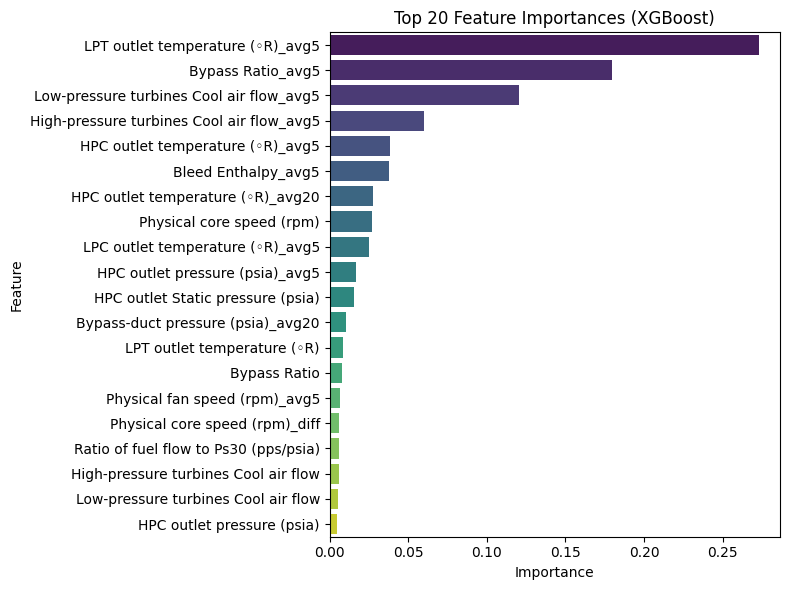

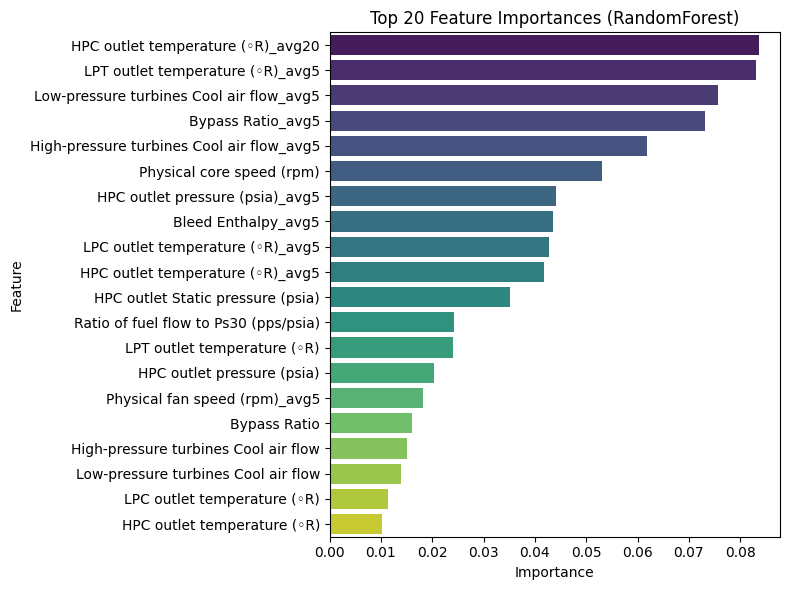

In [30]:
def plot_feature_importance(model, X, title, top_n=20):
    fi = pd.DataFrame({'Feature': X.columns, 'Importance': model.feature_importances_})
    fi = fi.sort_values('Importance', ascending=False).head(top_n)
    plt.figure(figsize=(8,6))
    sns.barplot(x='Importance', y='Feature', data=fi, palette='viridis')
    plt.title(title)
    plt.tight_layout()
    plt.show()
    return fi

fi_xgb = plot_feature_importance(best_xgb, X_corr_filtered, "Top 20 Feature Importances (XGBoost)")
fi_rf  = plot_feature_importance(best_rf,  X_corr_filtered, "Top 20 Feature Importances (RandomForest)")

### LSTM MODEL FOR RUL PREDICTION

In [11]:
#lstm_features = top_sensors + ['op_setting_1', 'op_setting_2']
lstm_features = train.drop(columns=['engine', 'cycle', 'cycle_norm', 'RUL']).columns

print("Features used for LSTM:", lstm_features)
print("Number of features:", len(lstm_features))

Features used for LSTM: Index(['op_setting_1', 'op_setting_2', 'LPC outlet temperature (◦R)',
       'HPC outlet temperature (◦R)', 'LPT outlet temperature (◦R)',
       'Bypass-duct pressure (psia)', 'HPC outlet pressure (psia)',
       'Physical fan speed (rpm)', 'Physical core speed (rpm)',
       'HPC outlet Static pressure (psia)',
       'Ratio of fuel flow to Ps30 (pps/psia)', 'Corrected fan speed (rpm)',
       'Corrected core speed (rpm)', 'Bypass Ratio', 'Bleed Enthalpy',
       'High-pressure turbines Cool air flow',
       'Low-pressure turbines Cool air flow',
       'LPC outlet temperature (◦R)_avg5', 'HPC outlet temperature (◦R)_avg5',
       'LPT outlet temperature (◦R)_avg5', 'Bypass-duct pressure (psia)_avg5',
       'HPC outlet pressure (psia)_avg5', 'Physical fan speed (rpm)_avg5',
       'Physical core speed (rpm)_avg5',
       'HPC outlet Static pressure (psia)_avg5',
       'Ratio of fuel flow to Ps30 (pps/psia)_avg5',
       'Corrected fan speed (rpm)_avg5', 'Co

In [12]:
# drop features with zero or near-zero variance
selector = VarianceThreshold(threshold=0.001)
X_reduced = selector.fit_transform(train[lstm_features])

selected_features = np.array(lstm_features)[selector.get_support()]
print("Remaining features:", len(selected_features))

Remaining features: 59


In [13]:
lstm_features = list(selected_features)

print("Features used for LSTM:", lstm_features)
print("Number of features:", len(lstm_features))

Features used for LSTM: ['LPC outlet temperature (◦R)', 'HPC outlet temperature (◦R)', 'LPT outlet temperature (◦R)', 'Bypass-duct pressure (psia)', 'HPC outlet pressure (psia)', 'Physical fan speed (rpm)', 'Physical core speed (rpm)', 'HPC outlet Static pressure (psia)', 'Ratio of fuel flow to Ps30 (pps/psia)', 'Corrected fan speed (rpm)', 'Corrected core speed (rpm)', 'Bypass Ratio', 'Bleed Enthalpy', 'High-pressure turbines Cool air flow', 'Low-pressure turbines Cool air flow', 'LPC outlet temperature (◦R)_avg5', 'HPC outlet temperature (◦R)_avg5', 'LPT outlet temperature (◦R)_avg5', 'Bypass-duct pressure (psia)_avg5', 'HPC outlet pressure (psia)_avg5', 'Physical fan speed (rpm)_avg5', 'Physical core speed (rpm)_avg5', 'HPC outlet Static pressure (psia)_avg5', 'Ratio of fuel flow to Ps30 (pps/psia)_avg5', 'Corrected fan speed (rpm)_avg5', 'Corrected core speed (rpm)_avg5', 'Bypass Ratio_avg5', 'Bleed Enthalpy_avg5', 'High-pressure turbines Cool air flow_avg5', 'Low-pressure turbines

chick null and inf in train and test datasets

In [14]:
train.isna().sum()[train.isna().sum() > 0]

LPC outlet temperature (◦R)_std5              100
HPC outlet temperature (◦R)_std5              100
LPT outlet temperature (◦R)_std5              100
Bypass-duct pressure (psia)_std5              100
HPC outlet pressure (psia)_std5               100
Physical fan speed (rpm)_std5                 100
Physical core speed (rpm)_std5                100
HPC outlet Static pressure (psia)_std5        100
Ratio of fuel flow to Ps30 (pps/psia)_std5    100
Corrected fan speed (rpm)_std5                100
Corrected core speed (rpm)_std5               100
Bypass Ratio_std5                             100
Bleed Enthalpy_std5                           100
High-pressure turbines Cool air flow_std5     100
Low-pressure turbines Cool air flow_std5      100
dtype: int64

In [17]:
np.isinf(train).sum()[np.isinf(train).sum() > 0]

Series([], dtype: int64)

In [18]:
test.isna().sum()[test.isna().sum() > 0]

LPC outlet temperature (◦R)_std5              100
HPC outlet temperature (◦R)_std5              100
LPT outlet temperature (◦R)_std5              100
Bypass-duct pressure (psia)_std5              100
HPC outlet pressure (psia)_std5               100
Physical fan speed (rpm)_std5                 100
Physical core speed (rpm)_std5                100
HPC outlet Static pressure (psia)_std5        100
Ratio of fuel flow to Ps30 (pps/psia)_std5    100
Corrected fan speed (rpm)_std5                100
Corrected core speed (rpm)_std5               100
Bypass Ratio_std5                             100
Bleed Enthalpy_std5                           100
High-pressure turbines Cool air flow_std5     100
Low-pressure turbines Cool air flow_std5      100
dtype: int64

In [19]:
np.isinf(test).sum()[np.isinf(test).sum() > 0]

Series([], dtype: int64)

drop the null values

In [21]:
# create time-series windows
def create_sequences(df, window, features):
    X, y = [], []
    for eng in df['engine'].unique():
        eng_df = df[df['engine'] == eng]
        eng_X = eng_df[features].values
        eng_y = eng_df['RUL'].values
        for i in range(len(eng_df) - window + 1):
            X.append(eng_X[i:i+window])
            y.append(eng_y[i+window-1])
    return np.array(X), np.array(y)

window_size = 40  # number of cycles per sequence
X_train_seq, y_train_seq = create_sequences(train.dropna(), window_size, lstm_features)
X_test_seq,  y_test_seq  = create_sequences(test.dropna(),  window_size, lstm_features)

print("Training sequence shape:", X_train_seq.shape)
print("Testing sequence shape:", X_test_seq.shape)

Training sequence shape: (16631, 40, 59)
Testing sequence shape: (9115, 40, 59)


In [22]:
print(np.isnan(X_train_seq).any(), np.isinf(X_train_seq).any())
print(np.isnan(y_train_seq).any(), np.isinf(y_train_seq).any())

False False
False False


In [23]:
# model builder for tuner (Conv1D + LSTM hybrid)
def build_model(hp):
    model = Sequential()

    # Conv1D feature extractor (temporal pattern learning)
    model.add(Conv1D(
        filters=hp.Int('filters', min_value=64, max_value=256, step=32),
        kernel_size=hp.Choice('kernel_size', [3, 5]),
        activation='relu',
        input_shape=(window_size, len(lstm_features))
    ))

    model.add(BatchNormalization())
    
    model.add(MaxPooling1D(pool_size=2))

    # First LSTM layer
    model.add(LSTM(
        units=hp.Int('units_1', min_value=64, max_value=256, step=64),
        return_sequences=True
    ))
    model.add(Dropout(hp.Float('dropout_1', min_value=0.1, max_value=0.25, step=0.1)))

    # Second LSTM layer
    model.add(LSTM(
        units=hp.Int('units_2', min_value=32, max_value=128, step=32),
        return_sequences=False
    ))
    model.add(Dropout(hp.Float('dropout_2', min_value=0.1, max_value=0.25, step=0.1)))

    # Dense output layers
    model.add(Dense(32, activation='relu'))
    model.add(Dense(1))

    # Compile model
    model.compile(
        optimizer=Adam(
            learning_rate=hp.Choice('learning_rate', [1e-3, 5e-4, 1e-4])
        ),
        loss='mse'
    )

    return model


In [24]:
# Create tuner
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=8,              # try 8 different combinations
    executions_per_trial=1,    # number of runs per combo
    overwrite=True,
    directory='tuning_results',
    project_name='LSTM_RUL_Tuning'
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [25]:
# Run search
es = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

tuner.search(
    X_train_seq, y_train_seq,
    epochs=30,
    batch_size=128,
    validation_split=0.2,
    callbacks=[es],
    verbose=1
) 

Trial 8 Complete [00h 04m 25s]
val_loss: 1177.8907470703125

Best val_loss So Far: 1177.8907470703125
Total elapsed time: 00h 29m 33s


Trial 8 Complete [00h 01m 35s]
val_loss: 5423.8408203125

Best val_loss So Far: 5325.255859375
Total elapsed time: 00h 11m 37s

In [1]:
best_trial = tuner.oracle.get_best_trials(num_trials=1)[0]
best_trial.summary()

Trial 7 summary
Hyperparameters:
filters: 256
kernel_size: 3
units_1: 256
dropout_1: 0.2
units_2: 96
dropout_2: 0.1
learning_rate: 0.0005
Score: 1177.8907470703125


In [2]:
history = best_trial.metrics.get_history('val_loss')
print(history)

[MetricObservation(value=[1177.8907470703125], step=8)]


In [3]:
best_model = tuner.get_best_models(num_models=1)[0]


es = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = best_model.fit(
    X_train_seq, y_train_seq,
    epochs=100,              # increase from 30 → 80–100
    batch_size=128,
    validation_split=0.2,
    callbacks=[es],
    verbose=1
)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 30 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Epoch 1/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 24s 166ms/step - loss: 255.2139 - val_loss: 1291.8511
Epoch 2/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - loss: 188.1958 - val_loss: 1370.2460
Epoch 3/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 22s 169ms/step - loss: 182.0768 - val_loss: 1768.4395
Epoch 4/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 18s 168ms/step - loss: 130.1839 - val_loss: 1455.6653
Epoch 5/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - loss: 102.8614 - val_loss: 1337.4694
Epoch 6/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - loss: 83.3533 - val_loss: 1421.9082
Epoch 7/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 18s 171ms/step - loss: 80.0103 - val_loss: 1478.8904
Epoch 8/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 18s 172ms/step - loss: 84.9730 - val_loss: 1744.2223
Epoch 9/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 16s 158ms/step - loss: 80.4687 - val_loss: 1851.6481
Epoch 10/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 16s 156ms/step - loss: 75.4450 - val_loss: 1445.9662
Epoch 11/100
104/104 ━━━━━━━━━━━━━━━━━━━━ 16s 157ms/st

In [1]:
best_model.save("best_rul_model.keras") 

MODEL EVALUATION ON TEST SET

In [1]:
# Generate predictions

y_pred_seq = best_model.predict(X_test_seq).flatten()

285/285 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step


In [4]:
# Compute metrics

rmse = np.sqrt(mean_squared_error(y_test_seq, y_pred_seq))
mae  = mean_absolute_error(y_test_seq, y_pred_seq)
r2   = r2_score(y_test_seq, y_pred_seq)

print("Final Model Evaluation Metrics")
print("=================================")
print(f"RMSE (Root Mean Squared Error): {rmse:.4f}")
print(f"MAE  (Mean Absolute Error):     {mae:.4f}")
print(f"R²   (Coefficient of Determination): {r2:.4f}")

Final Model Evaluation Metrics
RMSE (Root Mean Squared Error): 36.3566
MAE  (Mean Absolute Error):     27.5734
R²   (Coefficient of Determination): 0.5333


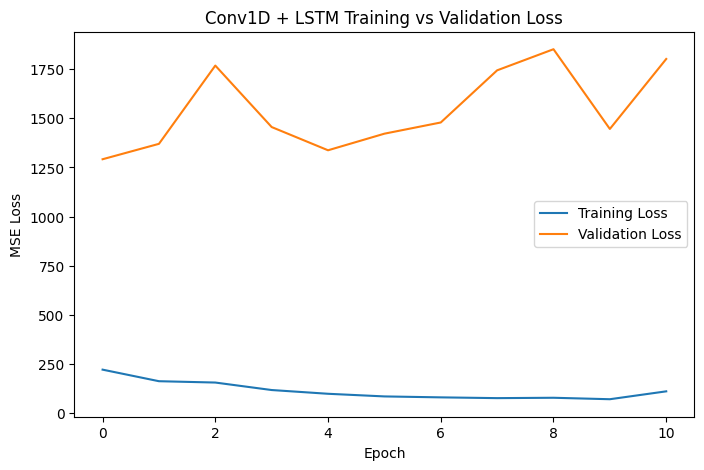

In [11]:
# Plot training curves

plt.figure(figsize=(8,5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('MSE Loss')
plt.legend()
plt.title('Conv1D + LSTM Training vs Validation Loss')
plt.show()

The training loss decreases steadily and remains low, while the validation loss fluctuates at higher values, indicating slight overfitting.
This suggests that while the model fits the training data well, further regularization or tuning could improve generalization on unseen sequences.”

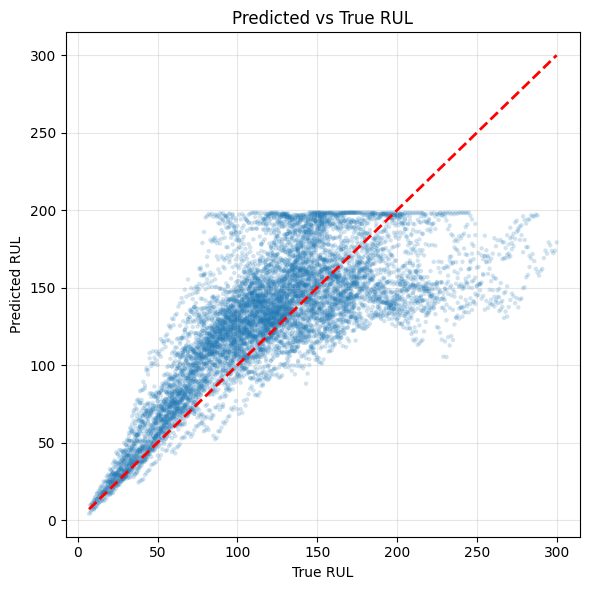

In [10]:
# Visualization 1: Predicted vs True RUL Scatter

plt.figure(figsize=(6,6))
plt.scatter(y_test_seq, y_pred_seq, alpha=0.2, s=10, edgecolors='none')
#sns.kdeplot(x=y_test_seq, y=y_pred_seq, fill=True, cmap="Blues", thresh=0.05, levels=50)
plt.plot([y_test_seq.min(), y_test_seq.max()],
         [y_test_seq.min(), y_test_seq.max()], 'r--', lw=2)
plt.xlabel("True RUL")
plt.ylabel("Predicted RUL")
plt.title("Predicted vs True RUL")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

* The red dashed line indicates perfect predictions (y = x)

* Points on the red line → perfect predictions

* Points below the line → model underestimated the RUL
(predicted lower than true → thinks engine will fail sooner)

* Points above the line → model overestimated the RUL
(predicted higher than true → thinks engine will last longer)

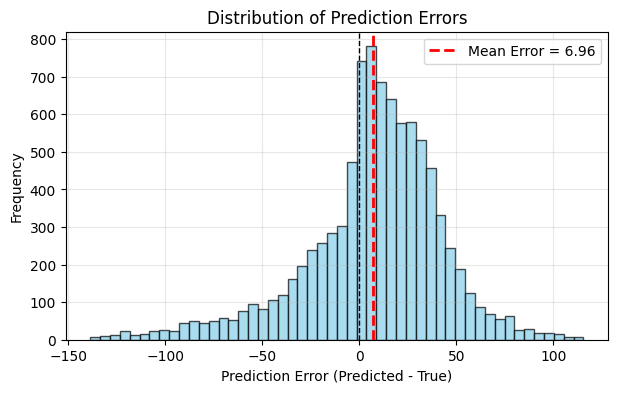

In [19]:
# Visualization 2: Error distribution

errors = y_pred_seq - y_test_seq
plt.figure(figsize=(7,4))
plt.hist(errors, bins=50, color='skyblue', edgecolor='black', alpha=0.7)
plt.axvline(0, color='black', linestyle='--', linewidth=1)
plt.axvline(errors.mean(), color='red', linestyle='--', linewidth=2,
            label=f"Mean Error = {errors.mean():.2f}")
plt.xlabel("Prediction Error (Predicted - True)")
plt.ylabel("Frequency")
plt.title("Distribution of Prediction Errors")
plt.legend()
plt.grid(alpha=0.3)


* Error=Predicted RUL−True RUL
* On average, the model overestimates RUL by about 7 cycles → model tends to think engines will last slightly longer than they actually do.
* Most predictions are within ±50 cycles of the true value
* The histogram is roughly bell-shaped and centered near zero. It means the model’s errors are mostly random and the model is nearly unbiased.

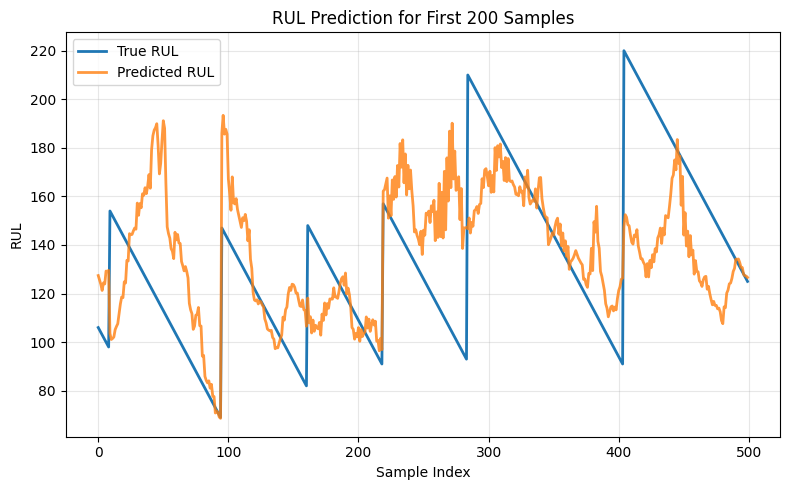

In [27]:
# Visualization 3: RUL progression for sample engines

plt.figure(figsize=(8,5))
plt.plot(y_test_seq[:500], label='True RUL', linewidth=2)
plt.plot(y_pred_seq[:500], label='Predicted RUL', linewidth=2, alpha=0.8)
plt.title("RUL Prediction for First 200 Samples")
plt.xlabel("Sample Index")
plt.ylabel("RUL")
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


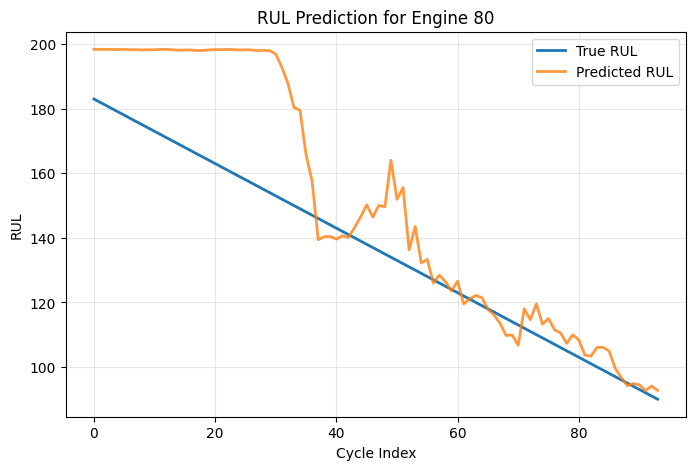

In [29]:
engine_id = 80  # choose a specific engine
engine_df = test[test['engine'] == engine_id]

X_engine, y_engine = create_sequences(engine_df, window_size, lstm_features)
y_pred_engine = best_model.predict(X_engine).flatten()

plt.figure(figsize=(8,5))
plt.plot(range(len(y_engine)), y_engine, label='True RUL', lw=2)
plt.plot(range(len(y_pred_engine)), y_pred_engine, label='Predicted RUL', lw=2, alpha=0.8)
plt.title(f"RUL Prediction for Engine {engine_id}")
plt.xlabel("Cycle Index")
plt.ylabel("RUL")
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()
